# DAMI Eliza IMMOWEB Analysis

In [74]:
import folium
import pandas as pd
import plotly.graph_objs as go
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.io as pio
import numpy as np
import re

### Cleaning up the data

In [75]:
### Cleaning up the data
csv_file_path = '../data/clean/cleaned_row_immoweb_data0403.csv'

# Read the CSV file and create a DataFrame
df = pd.read_csv(csv_file_path)
df = df.rename_axis("id")

df = df.drop('id', axis=1)
df = df.drop_duplicates(subset=['region', 'province','district','locality','postalcode','latitude','longitude','price_main','type','subtype','heatingType','cadastralIncome','epcScores','primaryEnergyConsumption','bedrooms','surface','surfaceGood','hasGasWaterElectricityConnection','condition','facadeCount','hasKitchenSetup','isFurnished','fireplaceExists','hasSwimmingPool','terraceSurface','floodZone','gardenSurface'])


# # Filter rows based on the 'region' column
# df = df[df['region'].isin(regions_to_keep)]

regions_to_keep = ["Wallonie", "Flanders", "Brussels"]


# Define latitude and longitude ranges
latitude_range = (48, 51.5)
longitude_range = (2.5, 6.5)

# Filter rows based on region and latitude/longitude ranges
df = df[df['region'].isin(regions_to_keep) & 
                 (df['latitude'].between(*latitude_range)) & 
                 (df['longitude'].between(*longitude_range))]

df = df[df['subtype'].str.lower() != 'castle']

# Replace 'Antwerpen' with 'Antwerp' in the 'city' column
df['locality'] = df['locality'].replace('Antwerpen', 'Antwerp')

epc_score_groups = {
    'A++': 'A++',
    'A+': 'A+',
    'A+_A++': 'A+',
    'A_A+': 'A',
    'A': 'A',
    'B': 'B',
    'C' : 'C',
    'D': 'D',
    'F_B': 'F',
    'F_C': 'F',
    'F_E': 'F',
    'F': 'F',
    'G_C': 'G',
    'G_D': 'G',
    'G_E': 'G',
    'G_F': 'G',
    'G': 'G'
}

# Map the EPC scores to groups
df['epcScores'] = df['epcScores'].map(epc_score_groups)# Calculate price per square meter

df['type'].replace({'HOUSE_GROUP': 'HOUSE', 'APARTMENT_GROUP': 'APARTMENT'}, inplace=True)

# Now, you can count the number of houses and apartments in the DataFrame
house_count = df[df['type'] == 'HOUSE'].shape[0]
apartment_count = df[df['type'] == 'APARTMENT'].shape[0]


C:\Users\arian\AppData\Local\Temp\ipykernel_26564\1145199351.py:55: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['type'].replace({'HOUSE_GROUP': 'HOUSE', 'APARTMENT_GROUP': 'APARTMENT'}, inplace=True)


In [76]:
# Function to remove outliers from a dataframe
def remove_outliers(df):
    # Calculate z-scores for selected columns
    z_scores = np.abs((df[columns_to_check] - df[columns_to_check].mean()) / df[columns_to_check].std())
    
    # Define a threshold for identifying outliers (e.g., z-score > 3)
    threshold = 3
    
    # Find outliers
    outliers_index = df[(z_scores > threshold).any(axis=1)].index
    
    # Remove outliers from the dataframe
    df_cleaned = df.drop(outliers_index)
    
    return df_cleaned

# Define columns for which you want to check outliers
columns_to_check = ['price_main', 'cadastralIncome', 'primaryEnergyConsumption', 'bedrooms', 'surface', 'surfaceGood', 'terraceSurface', 'gardenSurface']

# Calculate z-scores for selected columns
z_scores = np.abs((df[columns_to_check] - df[columns_to_check].mean()) / df[columns_to_check].std())

# Define a threshold for identifying outliers (e.g., z-score > 3)
threshold = 3

# Find outliers
outliers = df[(z_scores > threshold).any(axis=1)]

house_df = df[df['type'] == "HOUSE"]
apartment_df = df[df['type'] == "APARTMENT"]

# Remove outliers from house_df
filtered_house_df = remove_outliers(house_df)
print(filtered_house_df.shape)
print(house_df.shape)

# Remove outliers from apartment_df
filtered_apartment_df = remove_outliers(apartment_df)
print(filtered_apartment_df.shape)
print(apartment_df.shape)

(35419, 28)
(36458, 28)
(25082, 28)
(25692, 28)


locality
Antwerp                1650
Gent                   1073
Oostende                957
Knokke-Heist            863
Liège                   672
                       ... 
UDANGE                    1
LENS                      1
LUTLOMMEL                 1
BOUSSU-BOIS               1
Knesselare (Aalter)       1
Name: count, Length: 4367, dtype: int64


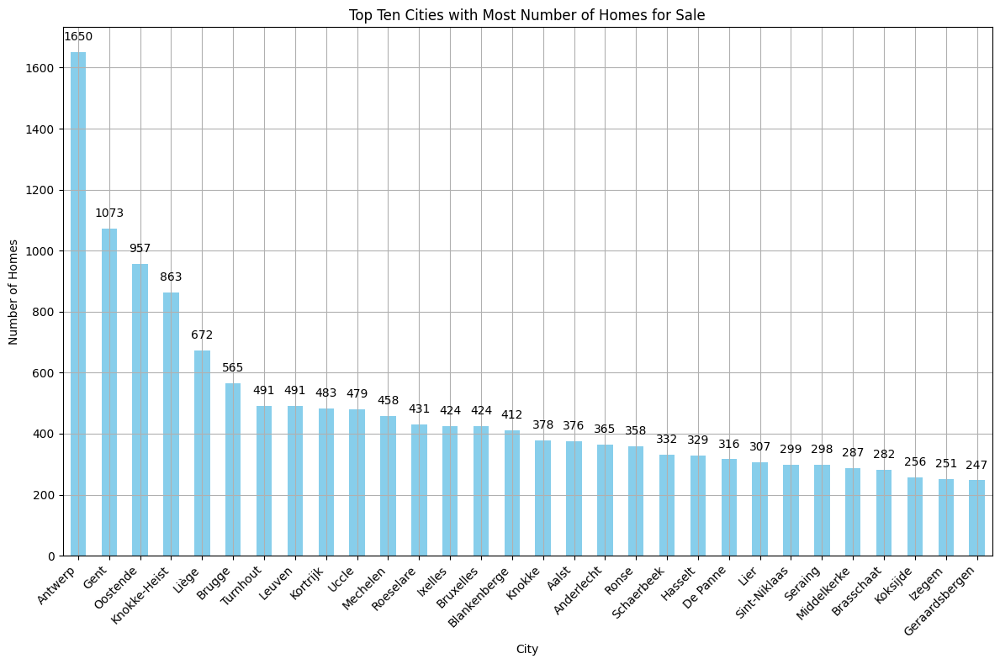

In [77]:
# Group by locality (city) and count the number of homes for each city
homes_per_city = df['locality'].value_counts()
print(homes_per_city)

# Sort cities by the number of homes in descending order and select the top ten cities
top_ten_cities = homes_per_city.sort_values(ascending=False).head(30)

# Plot the bar chart
plt.figure(figsize=(12, 8))
ax = top_ten_cities.plot(kind='bar', color='skyblue')

plt.title('Top Ten Cities with Most Number of Homes for Sale')
plt.xlabel('City')
plt.ylabel('Number of Homes')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels and align them to the right
plt.grid(True)
plt.tight_layout()

# Annotate the bars with the number of homes
for i, (city, num_homes) in enumerate(top_ten_cities.items()):
    ax.annotate(f"{num_homes}", (i, num_homes), textcoords="offset points", xytext=(0,10), ha='center')

plt.show()

In [78]:
# Drop rows with NaN values in latitude or longitude columns
filtered_apartment_df = filtered_apartment_df.dropna(subset=['latitude', 'longitude'])

# Get the maximum and minimum latitude and longitude from the DataFrame
max_lat_app = filtered_apartment_df['latitude'].max()
min_lat_app = filtered_apartment_df['latitude'].min()
max_lon_app = filtered_apartment_df['longitude'].max()
min_lon_app = filtered_apartment_df['longitude'].min()

# Calculate the center of the map
center_lat_app = (max_lat_app + min_lat_app) / 2
center_lon_app = (max_lon_app + min_lon_app) / 2

# Create a folium map centered around Belgium
belgium_map = folium.Map(location=[center_lat_app, center_lon_app], zoom_start=8)

# Add a marker for each property
for index, row in filtered_apartment_df.iterrows():
    folium.CircleMarker(location=[row['latitude'], row['longitude']], radius=3, fill=True, fill_opacity=0.2, color='none', fill_color='green').add_to(belgium_map)

# Display the map
belgium_map

In [79]:
# Drop rows with NaN values in latitude or longitude columns
filtered_house_df = filtered_house_df.dropna(subset=['latitude', 'longitude'])

# Get the maximum and minimum latitude and longitude from the DataFrame
max_lat_house = filtered_house_df['latitude'].max()
min_lat_house = filtered_house_df['latitude'].min()
max_lon_house = filtered_house_df['longitude'].max()
min_lon_house = filtered_house_df['longitude'].min()

# Calculate the center of the map
center_lat_house = (max_lat_house + min_lat_house) / 2
center_lon_house = (max_lon_house + min_lon_house) / 2

# Create a folium map centered around Belgium
belgium_map = folium.Map(location=[center_lat_house, center_lon_house], zoom_start=8)

# Add a marker for each property
for index, row in filtered_house_df.iterrows():
    folium.CircleMarker(location=[row['latitude'], row['longitude']], radius=3, fill=True, fill_opacity=0.2, color='none', fill_color='blue').add_to(belgium_map)

# Display the map
belgium_map



In [80]:
top_30_districts_ap = filtered_apartment_df['locality'].value_counts().head(30)
top_30_districts_house = filtered_house_df['locality'].value_counts().head(30)

# Filter the DataFrame to keep only the rows in the top 30 districts
filtered_apartment_df = filtered_apartment_df[filtered_apartment_df['locality'].isin(top_30_districts_ap.index)]
filtered_house_df = filtered_house_df[filtered_house_df['locality'].isin(top_30_districts_house.index)]

# Number of unique districts in filtered_apartment_df
unique_districts_apartment = filtered_apartment_df['locality'].nunique()
print("Number of unique districts in filtered_apartment_df:", unique_districts_apartment)

# Number of unique districts in filtered_house_df
unique_districts_house = filtered_house_df['locality'].nunique()
print("Number of unique districts in filtered_house_df:", unique_districts_house)

Number of unique districts in filtered_apartment_df: 30
Number of unique districts in filtered_house_df: 30


In [81]:
# # Total number of houses
# total_houses = filtered_house_df.shape[0]

# # Count the number of houses in the top 30 districts
# houses_in_top_30_districts = filtered_house_df[filtered_house_df['locality'].isin(top_30_districts_house.index)].shape[0]

# # Calculate the percentage
# percentage_in_top_30_districts = (houses_in_top_30_districts / total_houses) * 100

# print("Percentage of houses in the top 30 locality:", percentage_in_top_30_districts)

# # Total number of houses
# total_app = filtered_apartment_df.shape[0]

# # Count the number of apartments in the top 30 districts
# apartments_in_top_30_districts = filtered_apartment_df[filtered_apartment_df['locality'].isin(top_30_districts_ap.index)].shape[0]

# # Calculate the percentage
# percentage_in_top_30_districts_ap = (apartments_in_top_30_districts / total_app) * 100

# print("Percentage of apartments in the top 30 locality:", percentage_in_top_30_districts_ap)

# Convert 'locality' column to string type
filtered_house_df['district'] = filtered_house_df['district'].astype(str)

# Count occurrences of each city and sort in descending order
house_city_counts = filtered_house_df['district'].value_counts().sort_values(ascending=False)

# Get the 30 most common cities
house_top_30_cities = house_city_counts.head(30)
print(house_top_30_cities.head())

# Convert to list
house_top_30_cities_list = house_top_30_cities.index.tolist()
print(len(house_top_30_cities_list))# Count the number of houses in the biggest cities
houses_in_biggest_cities = filtered_house_df[filtered_house_df['district'].isin(house_top_30_cities_list)].shape[0]

# Total number of houses
total_houses = filtered_house_df.shape[0]

# Calculate the percentage
percentage_in_biggest_cities = (houses_in_biggest_cities / total_houses) * 100

print("Percentage of houses in the biggest cities:", percentage_in_biggest_cities)



# Convert 'district' column to string type
filtered_apartment_df['district'] = filtered_apartment_df['district'].astype(str)

# Count occurrences of each city and sort in descending order
apartment_city_counts = filtered_apartment_df['district'].value_counts().sort_values(ascending=False)

# Get the 30 most common cities
apartment_top_30_cities = apartment_city_counts.head(30)
print(apartment_top_30_cities.head())

# Convert to list
apartment_top_30_cities_list = apartment_top_30_cities.index.tolist()
print(len(apartment_top_30_cities_list))  # Check the length of the list, just for verification

# Count the number of apartments in the biggest cities
apartments_in_biggest_cities = filtered_apartment_df[filtered_apartment_df['district'].isin(apartment_top_30_cities_list)].shape[0]

# Total number of apartments
total_apartments = filtered_apartment_df.shape[0]

# Calculate the percentage
percentage_in_biggest_cities_ap = (apartments_in_biggest_cities / total_apartments) * 100

print("Percentage of apartments in the biggest cities:", percentage_in_biggest_cities_ap)


district
Liège       732
Antwerp     590
Aalst       538
Gent        496
Kortrijk    464
Name: count, dtype: int64
18
Percentage of houses in the biggest cities: 100.0
district
Brussels    2111
Brugge      1331
Antwerp     1284
Oostend      956
Veurne       650
Name: count, dtype: int64
14
Percentage of apartments in the biggest cities: 100.0
